In [1]:
from PIL import Image
from torchvision import transforms
import matplotlib.pyplot as plt
import time
import numpy as np
import skimage
from skimage import exposure
from dataset.transform import *
from dataset.utils import *
from utils import *
import face_recognition
import pickle

In [15]:
import numpy as np
import pickle
# Load the data back
with open('recall.pkl', 'rb') as file:
    loaded_data = pickle.load(file)
# loaded_data
import pandas as pd    
df = pd.DataFrame({k:v for k, v in loaded_data.items()})
df.to_csv(r'file.csv')
{k:v for k, v in loaded_data.items()}
# {key:[np.mean(x) for x in val] for key,val in loaded_data.items() if 'HSV(method=sv' in key and 'mean' in key}

{'train_PA': [0.4929476879128727,
  0.562935190144617,
  0.6120335654347437,
  0.6564899125156222,
  0.6889841099803606,
  0.719514372433494],
 'test_PA': [0.07527138255994274,
  0.09304544912322557,
  0.11034235953715854,
  0.12871287128712872,
  0.15101992126923536,
  0.17117976857926756],
 'train_PA+Unsharp': [0.7568291376539904,
  0.7818246741653276,
  0.7993215497232637,
  0.8116407784324228,
  0.8225316907695055,
  0.8332440635600785],
 'test_PA+Unsharp': [0.12072050578551831,
  0.13742097101276393,
  0.14887271859716092,
  0.16318740307765717,
  0.17607061911010377,
  0.19265179530001192],
 'train_PA+MedianUnsharp+Median': [0.7786109623281556,
  0.7996786288162828,
  0.8121763970719514,
  0.8209248348509195,
  0.8271737189787538,
  0.8336011426530977],
 'test_PA+MedianUnsharp+Median': [0.12429917690564238,
  0.13861386138613863,
  0.15137778838124777,
  0.16294882500298222,
  0.1745198616247167,
  0.1889538351425504],
 'total_time': -5657.035493612289,
 'train_PA+AutoContrast+Me

In [54]:
import torch
from torch.utils.data import random_split

def split(full_dataset, val_percent, test_percent, random_seed=None):
    amount = len(full_dataset)

    test_amount = (
        int(amount * test_percent)
        if test_percent is not None else 0)
    val_amount = (
        int(amount * val_percent)
        if val_percent is not None else 0)
    train_amount = amount - test_amount - val_amount

    train_dataset, val_dataset, test_dataset = random_split(
        full_dataset,
        (train_amount, val_amount, test_amount),
        generator=(
            torch.Generator().manual_seed(random_seed)
            if random_seed
            else None))
    
    return train_dataset, val_dataset, test_dataset

full_dataset = make_dataset('LFW', split='10fold', image_size=100)
train_dataset, val_dataset, test_dataset = split(full_dataset, 0.0, 0.3, 1)

Files already downloaded and verified


In [23]:
dataset = make_dataset('LFWCustom', face_detection=False,split='train',image_size=100)
# [(c,len(face_recognition.face_locations(np.array(transforms.ToPILImage()(x))))) for c,x in enumerate([y[0] for y in dataset[:1000]]) if len(face_recognition.face_locations(np.array(transforms.ToPILImage()(x))))==0]

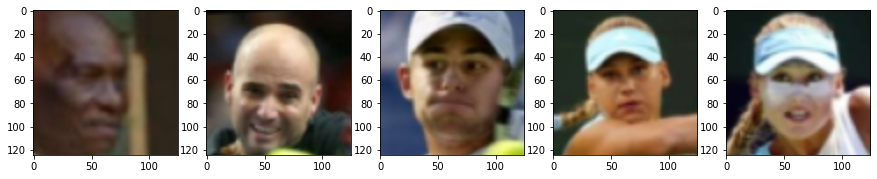

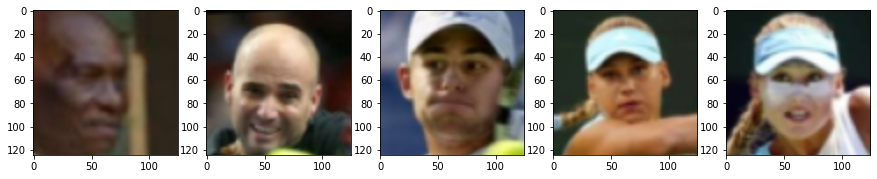

In [35]:
c=0
for i in [4,229,255,293,295]+[4,229,255,293,295]:
    if c==0:
        f, ax = plt.subplots(1,5,figsize=(3*5,3))
    ax[c].imshow(transforms.CenterCrop(125)(transforms.Resize((200,200))(transforms.ToPILImage()(dataset[i][0]))))
#     ax[c].imshow(transforms.CenterCrop(125)(transforms.Resize((200,200))(AutoContrast()(transforms.ToPILImage()(dataset[i][0])))))
    c+=1
    if c==5:
        c=0
        plt.show()
    

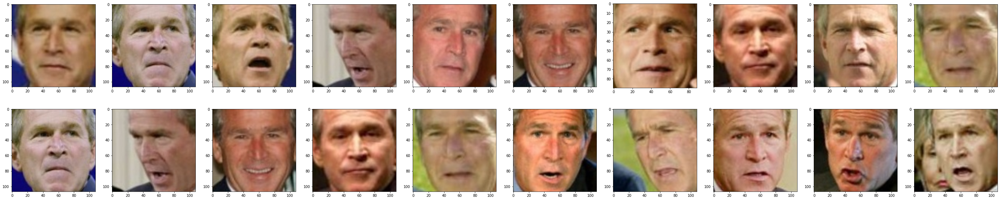

In [11]:
f,ax = plt.subplots(2,10, figsize=(50,10))

for j in range(2):
    for i in range(10):
        image_file = Image.open(f'./Clean/data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_00{(i+1)*(j+1):02d}.jpg')
        img = image_file.convert('RGB')
        face_locations = face_recognition.face_locations(np.array(img))
        U,R,D,L = face_locations[0]
        ax[j,i].imshow(img.crop([L,U,R,D]))

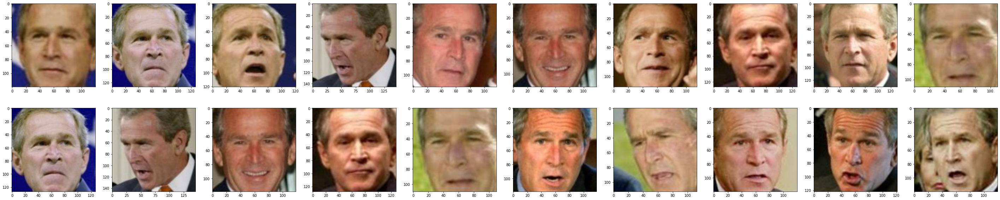

In [25]:
face_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_frontalface_default.xml"
)
f,ax = plt.subplots(2,10, figsize=(50,10))

for j in range(2):
    for i in range(10):
        image_file = Image.open(f'./Clean/data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_00{(i+1)*(j+1):02d}.jpg')
        img = image_file.convert('RGB')
        face_locations = face_classifier.detectMultiScale(
            np.array(img)[:,:,::-1], scaleFactor=1.1, minNeighbors=5, minSize=(90, 90)
        )
        x,y,w,h = face_locations[0]
        L,U,R,D = x,y,x+w,y+h
        ax[j,i].imshow(img.crop([L,U,R,D]))

In [16]:
image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_0020.jpg')
img = image_file.convert('RGB')
np.max(MedianUnsharpFilter(size=3,amount=2)(img))
# np.max(MedianHSVFilter(size=3)(img))
np.max(skimage.color.hsv2rgb(skimage.color.rgb2hsv(np.array(img))))

1.0

time:0.030013084411621094


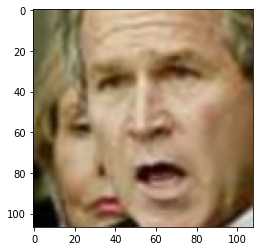

In [69]:
then=time.time()
image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_0020.jpg')
img = image_file.convert('RGB')
face_locations = face_recognition.face_locations(np.array(img))
print(f'time:{time.time()-then}')
U,R,D,L = face_locations[0]
plt.imshow(img.crop([L,U,R,D]))

time:0.0001647472381591797


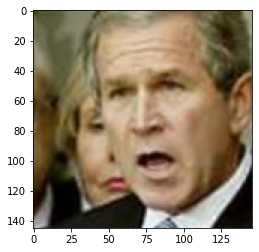

In [81]:
then=time.time()
image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_0020.jpg')
img = image_file.convert('RGB')
face_locations = face_recognition.face_locations(np.array(img))

# Your existing code to calculate face_locations
U, R, D, L = face_locations[0]
then=time.time()
# Calculate the width and height
width = R - L
height = D - U

# Define the scaling factor (e.g., 120% for a 20% increase)
scaling_factor = 1.35  # 120%

# Scale the width and height
new_width = width * scaling_factor
new_height = height * scaling_factor

# Calculate the new left (L) and top (U) coordinates
new_L = L - (new_width - width) / 2
new_U = U - (new_height - height) / 2

# Calculate the new right (R) and bottom (D) coordinates
new_R = new_L + new_width
new_D = new_U + new_height
print(f'time:{time.time()-then}')
# Display the scaled image region
plt.imshow(img.crop((new_L, new_U, new_R, new_D)))

time:0.015029191970825195


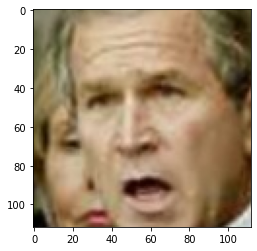

In [67]:
face_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_frontalface_default.xml"
)
then=time.time()
img = cv2.imread('./Clean/data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_0020.jpg')
face = face_classifier.detectMultiScale(
    img, scaleFactor=1.1, minNeighbors=5, minSize=(40, 40)
)
print(f'time:{time.time()-then}')
x,y,w,h=face[0]
img = image_file.convert('RGB')
plt.imshow(img.crop([x,y,x+w,y+h]))

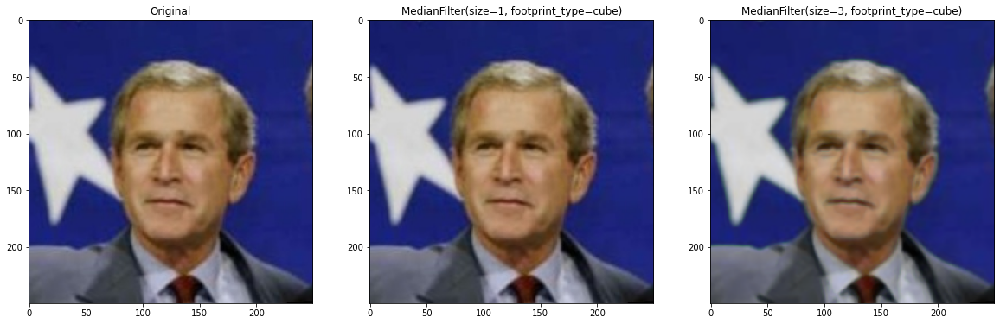

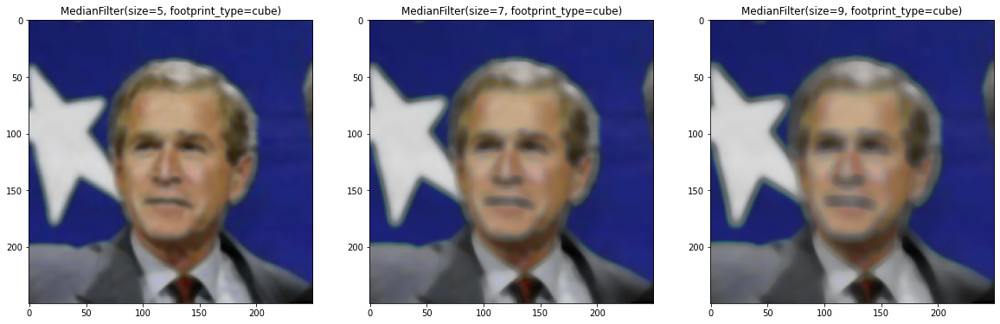

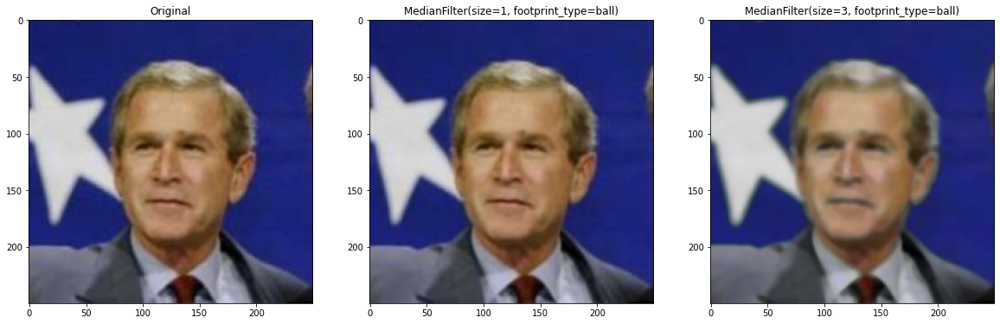

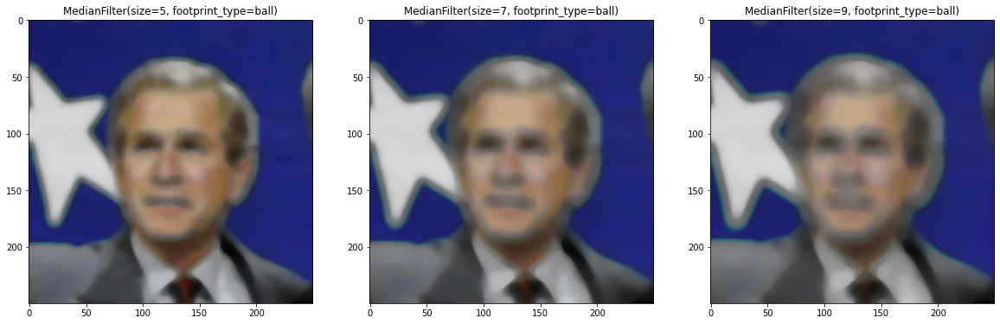

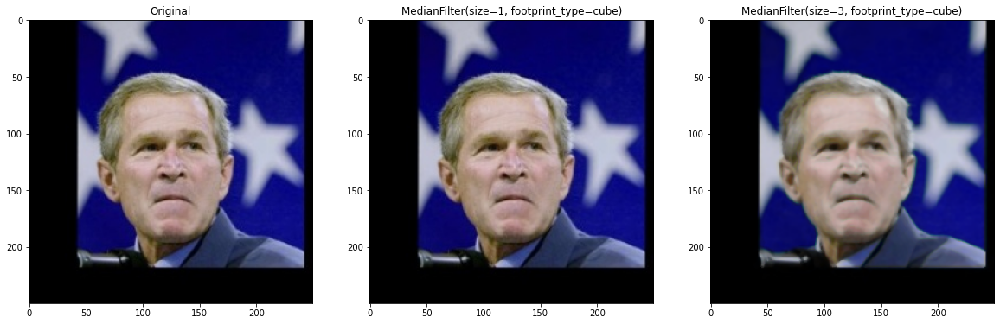

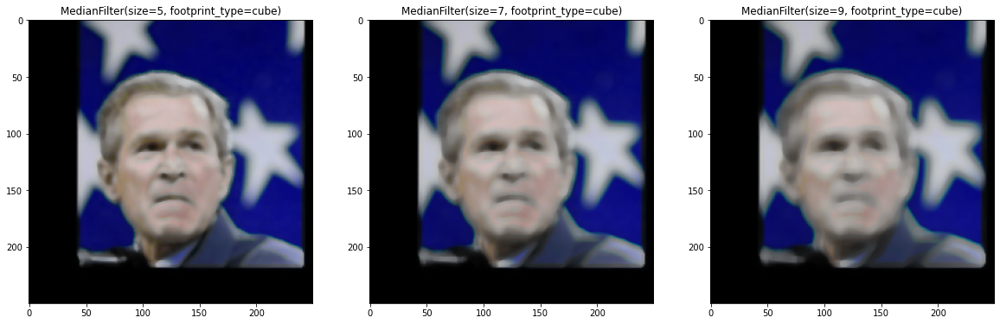

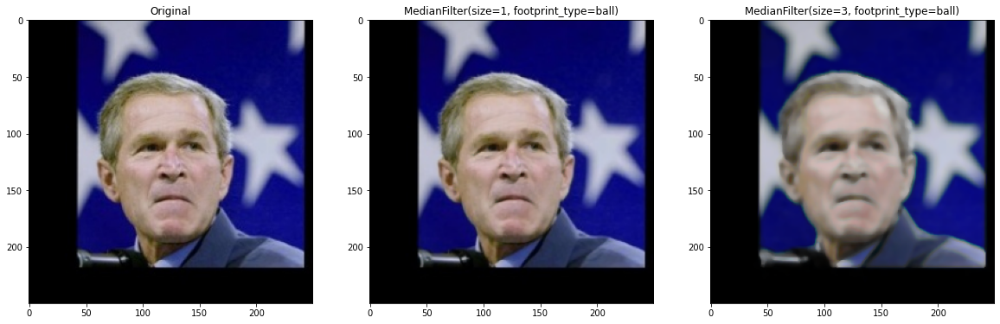

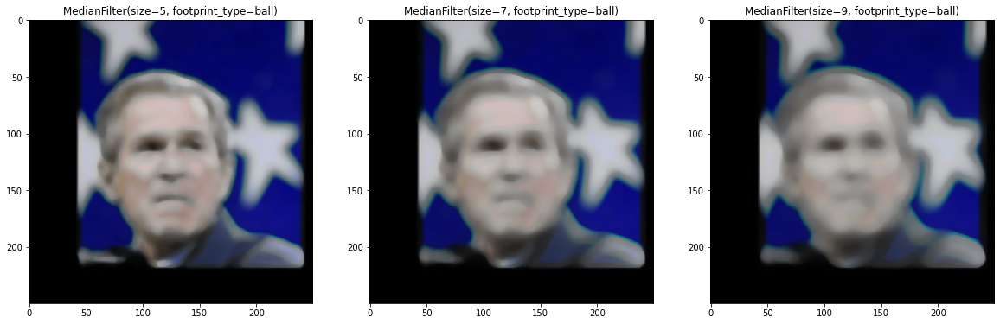

In [2]:
# try size 1 to 3!!! (later)
i=0
for j in range(2):
    image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_00{(i+1)*(j+1):02d}.jpg')
    img = image_file.convert('RGB')
#     for center_crop in range(2):
    for foottype in ['cube', 'ball']:
        f,ax=plt.subplots(1,3,figsize=(20,10))
        ax[0].imshow(img)
        ax[0].set_title('Original')
        size=1
        ax[1].imshow(MedianFilter(size=size, footprint_type=foottype)(img))
        ax[1].set_title(f'MedianFilter(size={size}, footprint_type={foottype})')
        size=3
        ax[2].imshow(MedianFilter(size=size, footprint_type=foottype)(img))
        ax[2].set_title(f'MedianFilter(size={size}, footprint_type={foottype})')
        plt.show()
        f,ax=plt.subplots(1,3,figsize=(20,10))
        size=5
        ax[0].imshow(MedianFilter(size=size, footprint_type=foottype)(img))
        ax[0].set_title(f'MedianFilter(size={size}, footprint_type={foottype})')
        size=7
        ax[1].imshow(MedianFilter(size=size, footprint_type=foottype)(img))
        ax[1].set_title(f'MedianFilter(size={size}, footprint_type={foottype})')
        size=9
        ax[2].imshow(MedianFilter(size=size, footprint_type=foottype)(img))
        ax[2].set_title(f'MedianFilter(size={size}, footprint_type={foottype})')
        plt.show()
#         img = transforms.CenterCrop(size=70)(img)

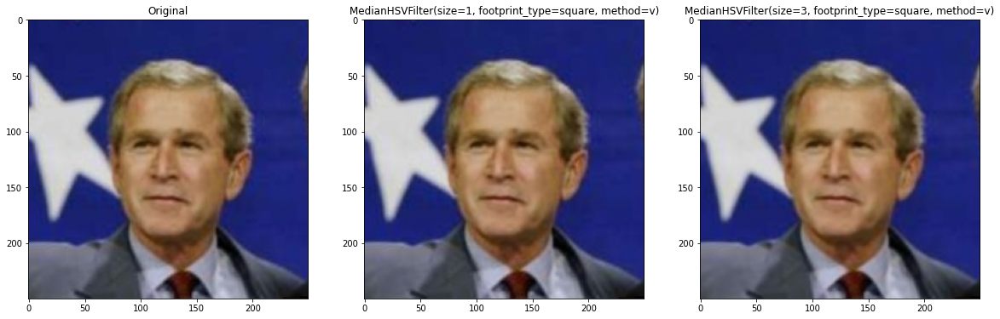

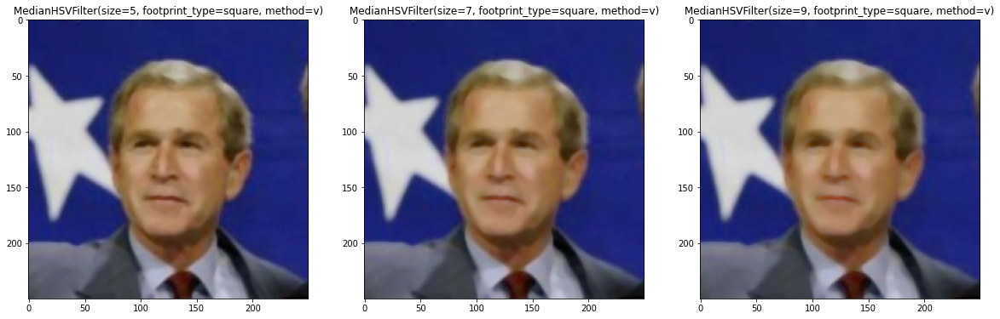

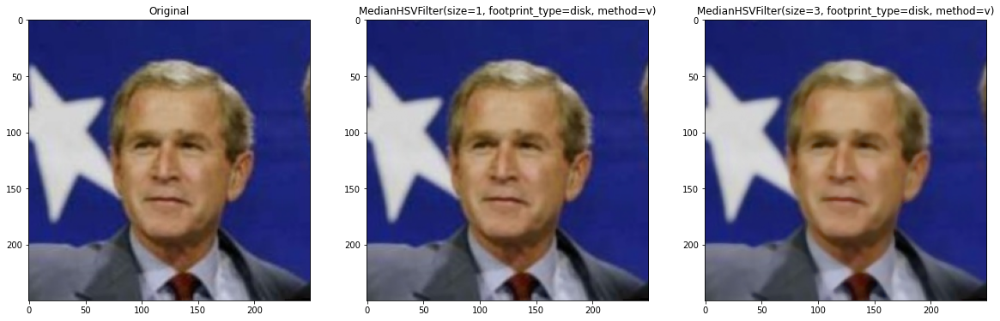

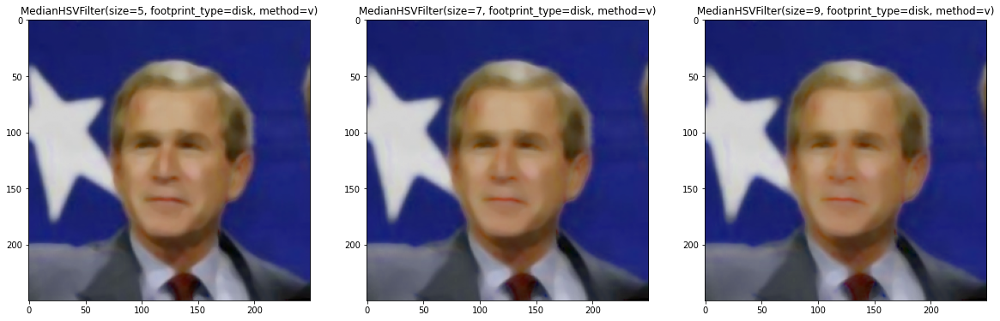

In [3]:
# try size 1 to 5!!! (later)
i=0
for j in range(1):
    image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_00{(i+1)*(j+1):02d}.jpg')
    img = image_file.convert('RGB')
#     for center_crop in range(2):
    for method in ['v']:
        for foottype in ['square','disk']:
            f,ax=plt.subplots(1,3,figsize=(20,10))
            ax[0].imshow(img)
            ax[0].set_title('Original')
            size=1
            ax[1].imshow(MedianHSVFilter(size=size, footprint_type=foottype)(img))
            ax[1].set_title(f'MedianHSVFilter(size={size}, footprint_type={foottype}, method={method})')
            size=3
            ax[2].imshow(MedianHSVFilter(size=size, footprint_type=foottype)(img))
            ax[2].set_title(f'MedianHSVFilter(size={size}, footprint_type={foottype}, method={method})')
            plt.show()
            f,ax=plt.subplots(1,3,figsize=(20,10))
            size=5
            ax[0].imshow(MedianHSVFilter(size=size, footprint_type=foottype)(img))
            ax[0].set_title(f'MedianHSVFilter(size={size}, footprint_type={foottype}, method={method})')
            size=7
            ax[1].imshow(MedianHSVFilter(size=size, footprint_type=foottype)(img))
            ax[1].set_title(f'MedianHSVFilter(size={size}, footprint_type={foottype}, method={method})')
            size=9
            ax[2].imshow(MedianHSVFilter(size=size, footprint_type=foottype)(img))
            ax[2].set_title(f'MedianHSVFilter(size={size}, footprint_type={foottype}, method={method})')
            plt.show()
#         img = transforms.CenterCrop(size=70)(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


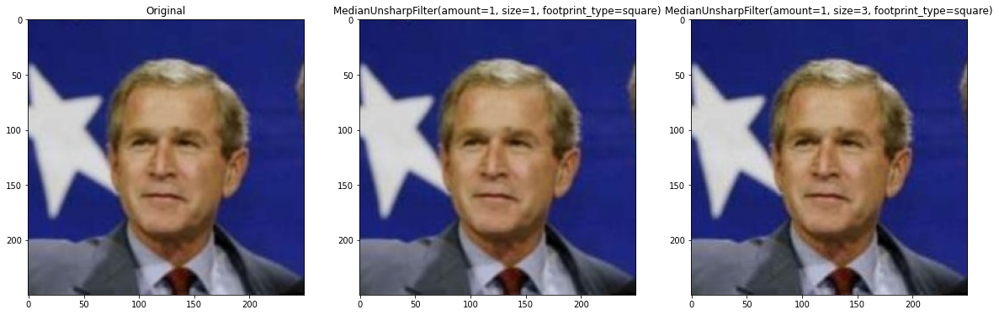

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


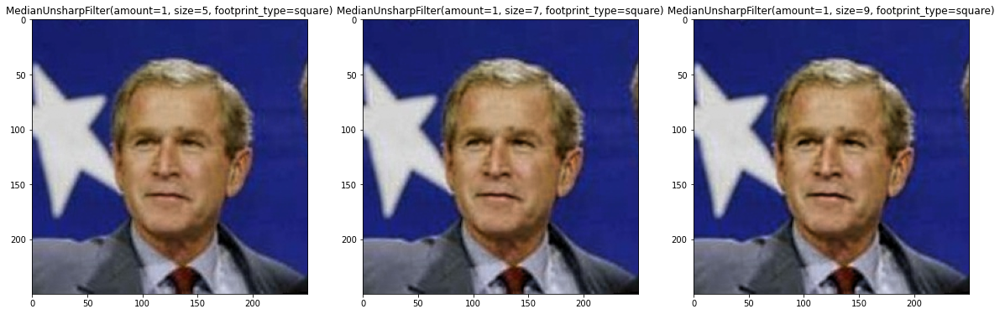

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


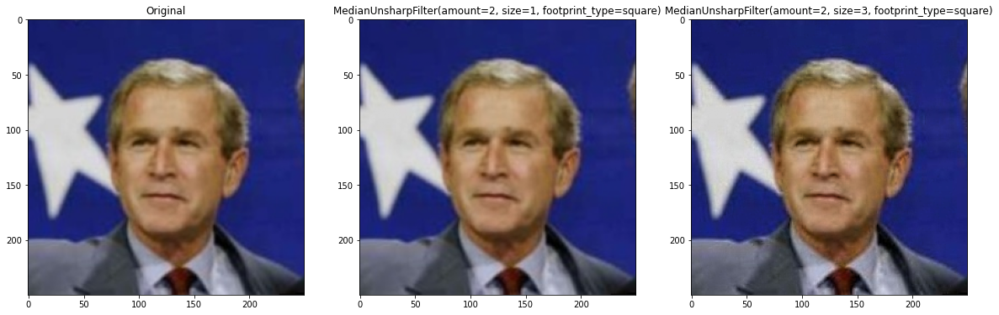

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


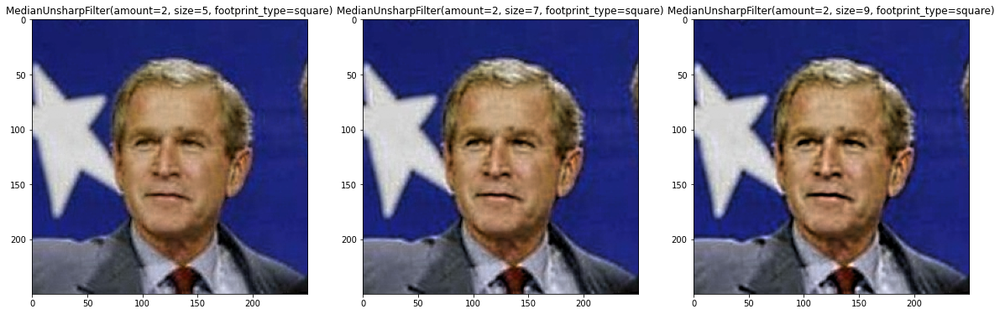

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


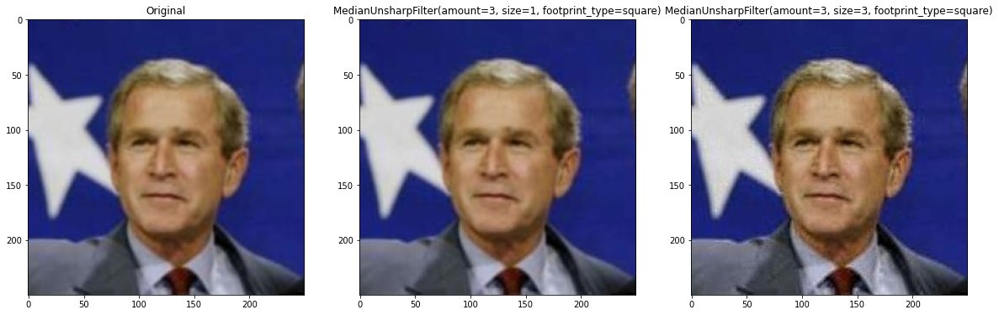

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


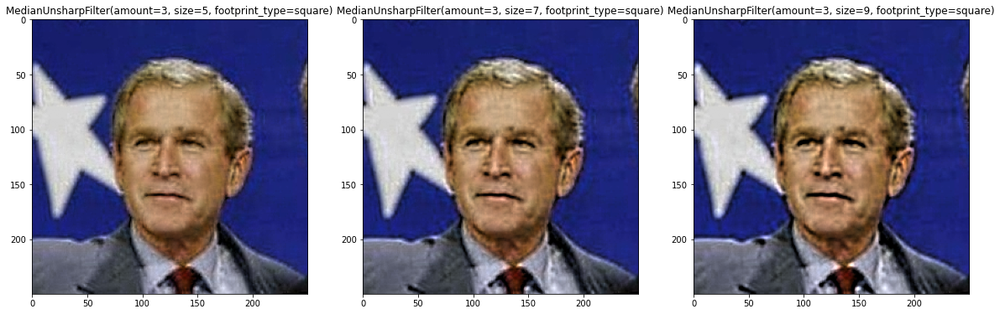

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


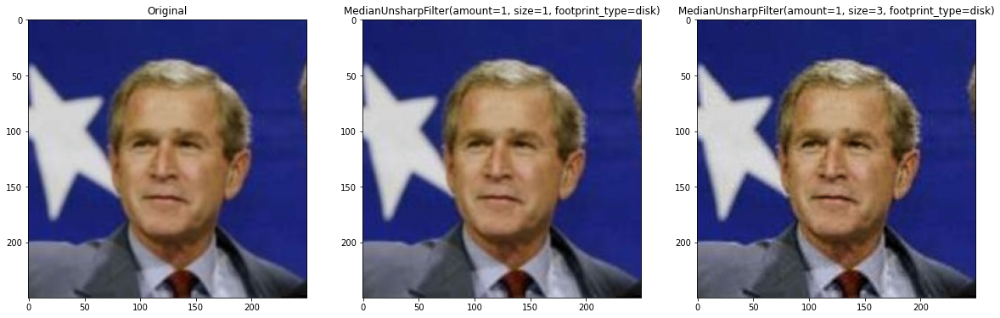

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


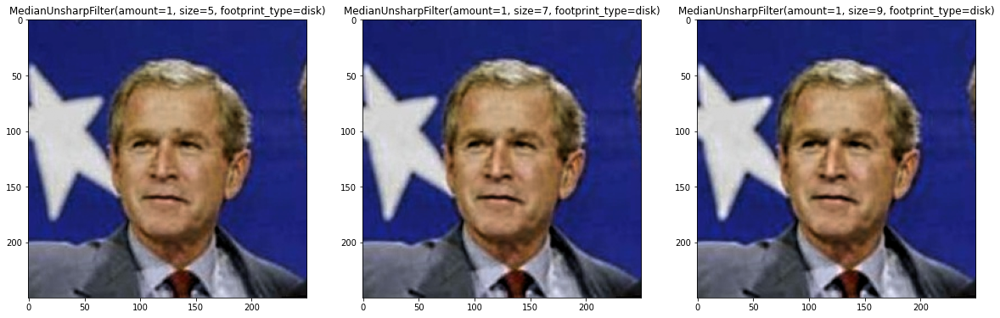

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


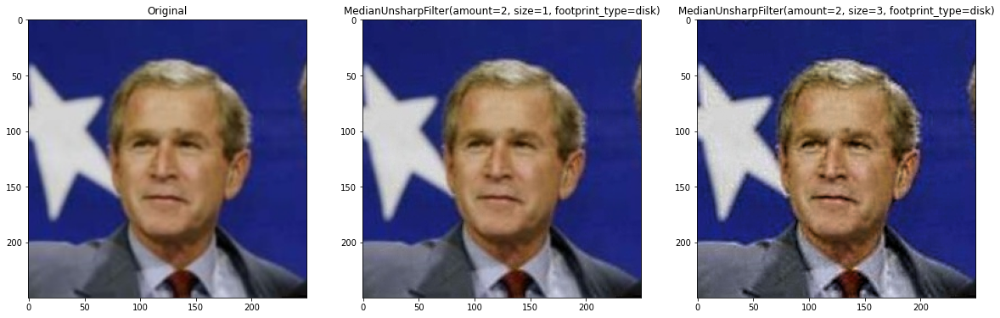

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


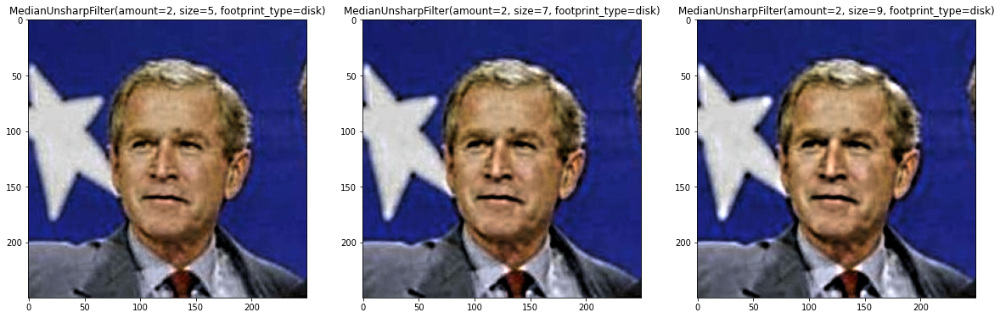

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


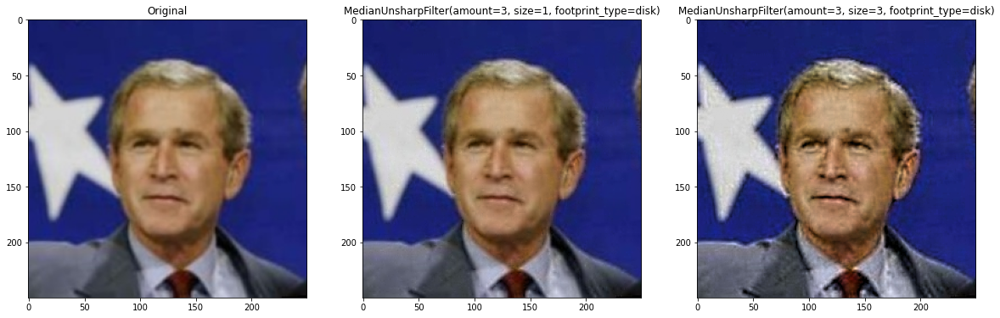

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


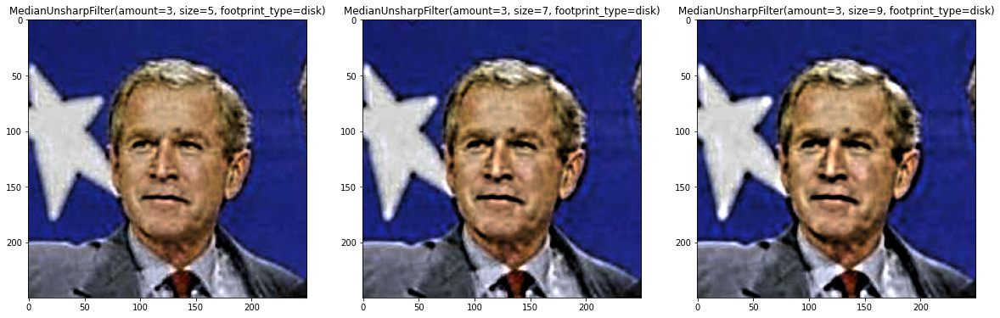

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


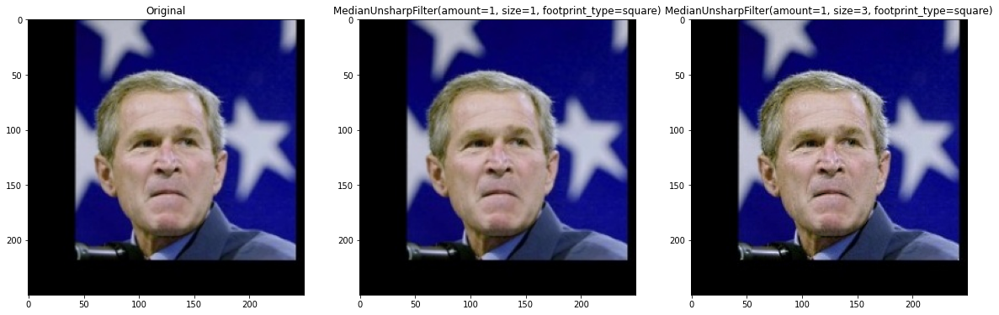

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


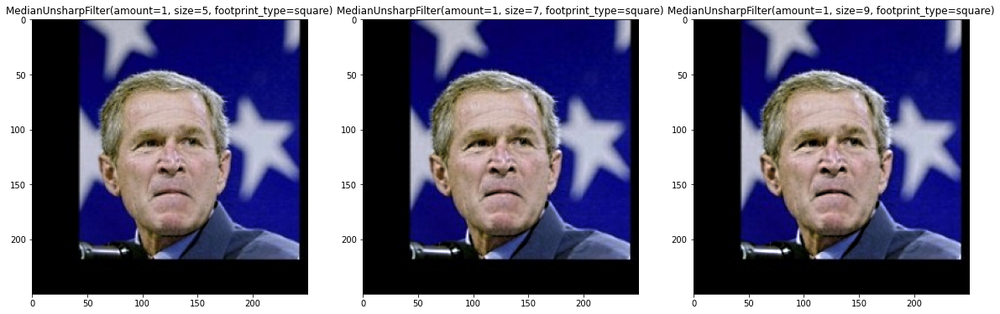

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


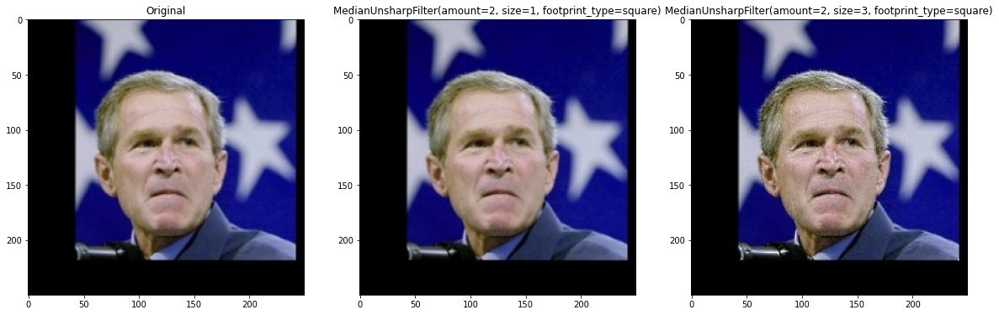

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


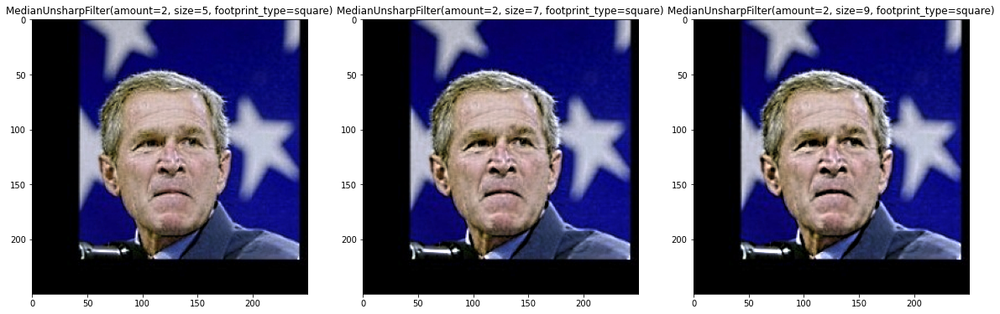

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


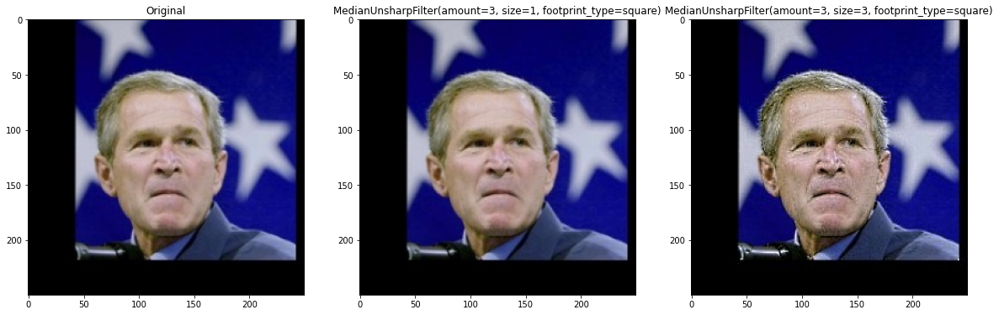

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


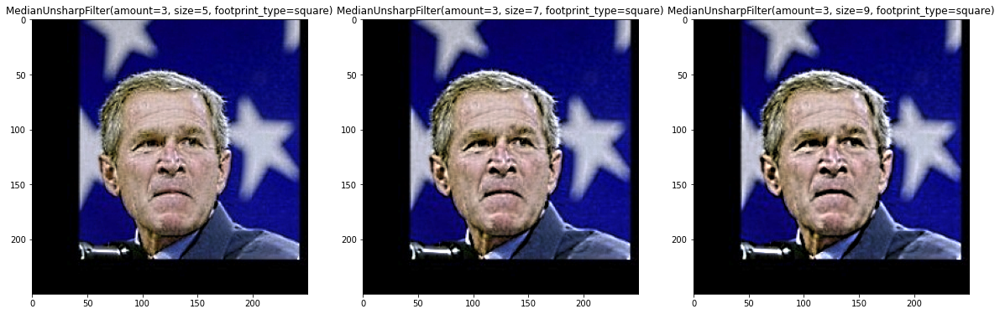

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


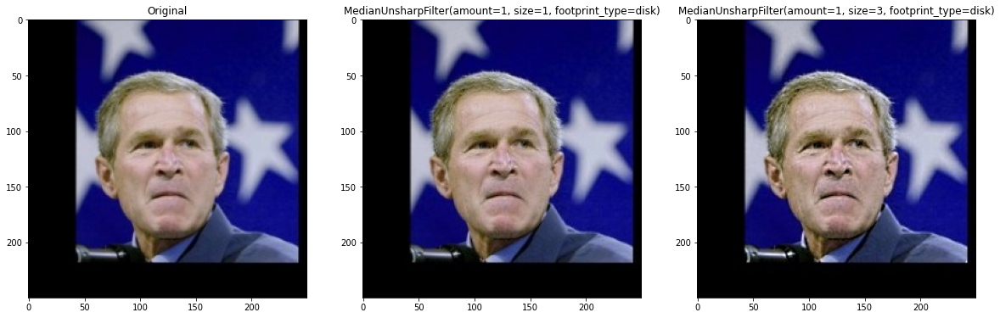

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


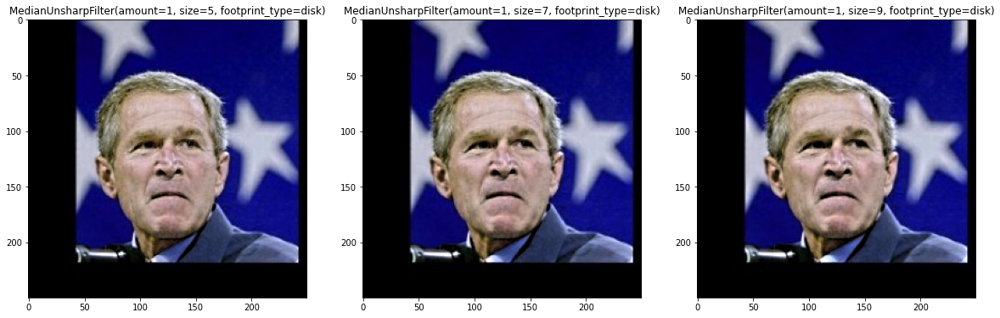

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


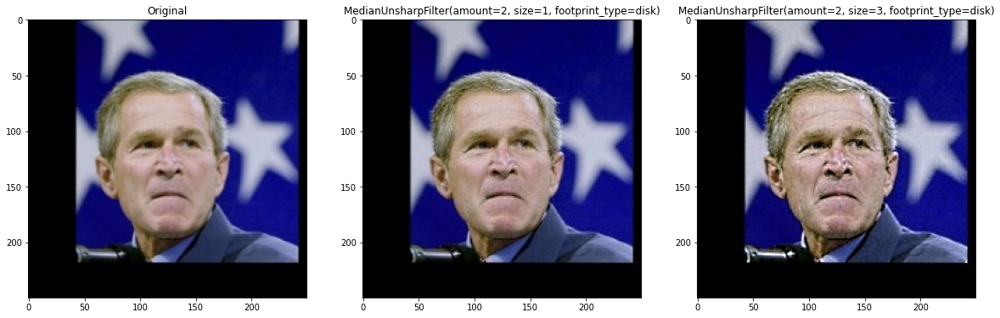

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


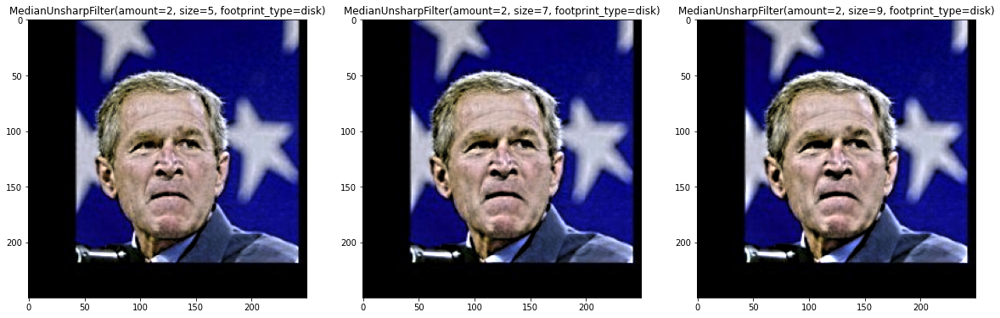

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


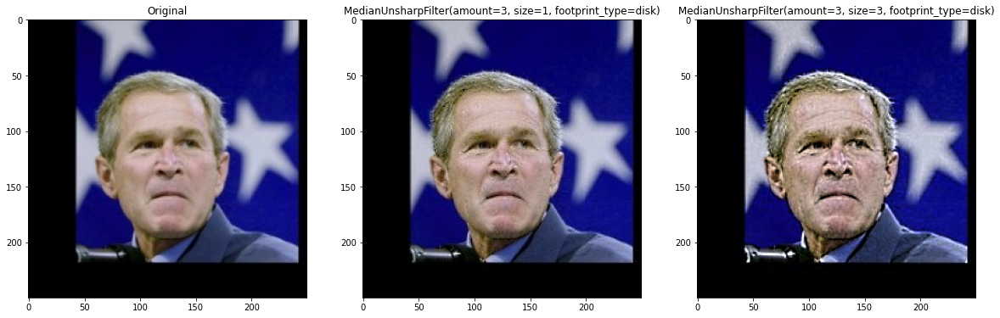

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


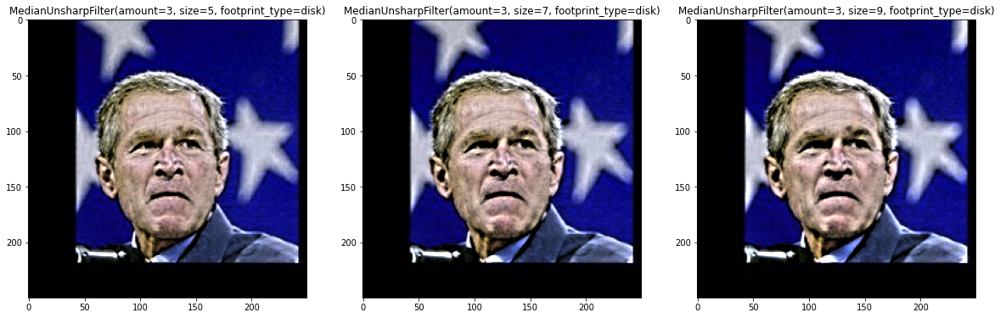

In [4]:
#amount=1, size=~9
#amount=2, size=~5
#amount=3, size=~3
i=0
for j in range(2):
    image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_00{(i+1)*(j+1):02d}.jpg')
    img = image_file.convert('RGB')
#     for center_crop in range(2):
    for foottype in ['square', 'disk']:
        for amount in [1,2,3]:
            f,ax=plt.subplots(1,3,figsize=(20,10))
            ax[0].imshow(img)
            ax[0].set_title('Original')
            size=1
            ax[1].imshow(MedianUnsharpFilter(amount=amount, size=size, footprint_type=foottype)(img))
            ax[1].set_title(f'MedianUnsharpFilter(amount={amount}, size={size}, footprint_type={foottype})')
            size=3
            ax[2].imshow(MedianUnsharpFilter(amount=amount, size=size, footprint_type=foottype)(img))
            ax[2].set_title(f'MedianUnsharpFilter(amount={amount}, size={size}, footprint_type={foottype})')
            plt.show()
            f,ax=plt.subplots(1,3,figsize=(20,10))
            size=5
            ax[0].imshow(MedianUnsharpFilter(amount=amount, size=size, footprint_type=foottype)(img))
            ax[0].set_title(f'MedianUnsharpFilter(amount={amount}, size={size}, footprint_type={foottype})')
            size=7
            ax[1].imshow(MedianUnsharpFilter(amount=amount, size=size, footprint_type=foottype)(img))
            ax[1].set_title(f'MedianUnsharpFilter(amount={amount}, size={size}, footprint_type={foottype})')
            size=9
            ax[2].imshow(MedianUnsharpFilter(amount=amount, size=size, footprint_type=foottype)(img))
            ax[2].set_title(f'MedianUnsharpFilter(amount={amount}, size={size}, footprint_type={foottype})')
            plt.show()
#         img = transforms.CenterCrop(size=70)(img)

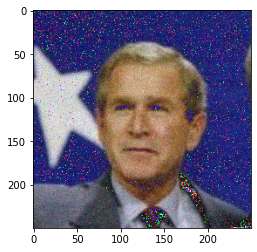

In [71]:
image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_0001.jpg')
img = image_file.convert('RGB')
then=time.time()
x=transforms.ToTensor()(img)
x= x + .2*((0.1**0.5)*torch.randn(3, 250, 250))
time.time()-then
plt.imshow(transforms.ToPILImage()(x))
# plt.imshow(RandomNoise()(x))

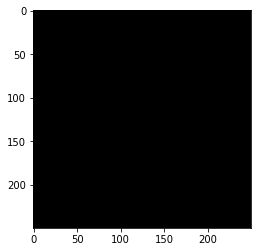

In [47]:
image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_0001.jpg')
img = image_file.convert('RGB')
img = np.array(img)
plt.imshow(AutoContrast()(img/255 - (MedianUnsharpFilter(size=1)(img))))

In [22]:
def logtime(then):
    print(time.time()-then)
    return time.time()

image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_0001.jpg')
img = image_file.convert('RGB')
then=time.time()
img = transforms.CenterCrop(125)(img)
then=logtime(then)
img = transforms.RandomHorizontalFlip(.5)(img)
then=logtime(then)
img = transforms.ColorJitter(brightness=.5, contrast=.5, saturation=.5, hue=.5)(img)
then=logtime(then)
img = GaussianBlur(sigma=3)(img)
then=logtime(then)
image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_0001.jpg')
img = image_file.convert('RGB')
then=logtime(then)
img = transforms.GaussianBlur(3)(img)
then=logtime(then)
img = AutoContrast()(img)
then=logtime(then)
img = MedianUnsharpFilter(size=1,amount=1)(img)
then=logtime(then)
img = MedianHSVFilter(method='sv',size=3)(img)
then=logtime(then)

0.0001990795135498047
0.0003561973571777344
0.09073305130004883
0.001878976821899414
0.0007433891296386719
0.013072490692138672
0.0006439685821533203
0.39803266525268555
0.18846774101257324


In [99]:
image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_0001.jpg')
img = image_file.convert('RGB')
then=time.time()
transforms.GaussianBlur(1)(img)
time.time()-then
plt.imshow()

0.19911742210388184

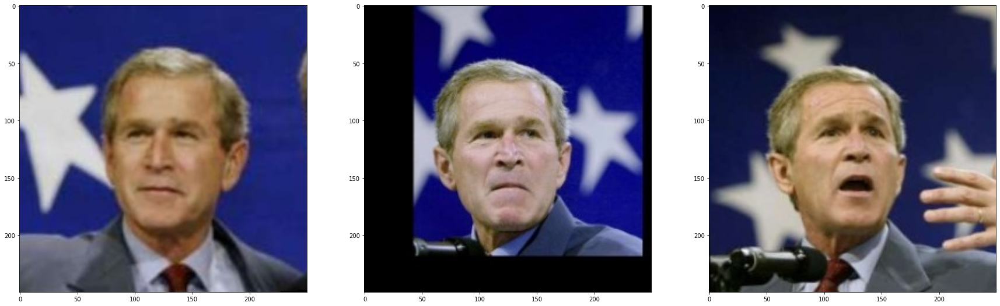

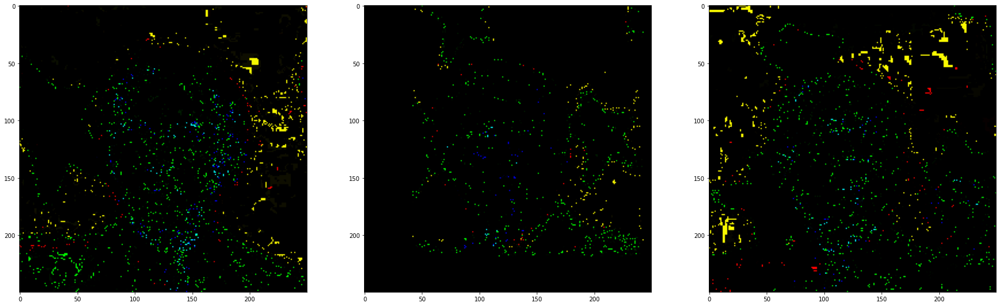

In [38]:
f,ax=plt.subplots(1,3,figsize=(30,10))
f2,ax2=plt.subplots(1,3,figsize=(30,10))
for i in range(1,4):
    image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_000{i}.jpg')
    img = image_file.convert('RGB')
    img = np.array(img)
    ax[i-1].imshow(img)
    ax2[i-1].imshow(AutoContrast()((MedianHSVFilter(size=3)(img) - MedianHSVFilter(size=3)(MedianUnsharpFilter(size=1,amount=1)((img))))*10**15))
plt.show()

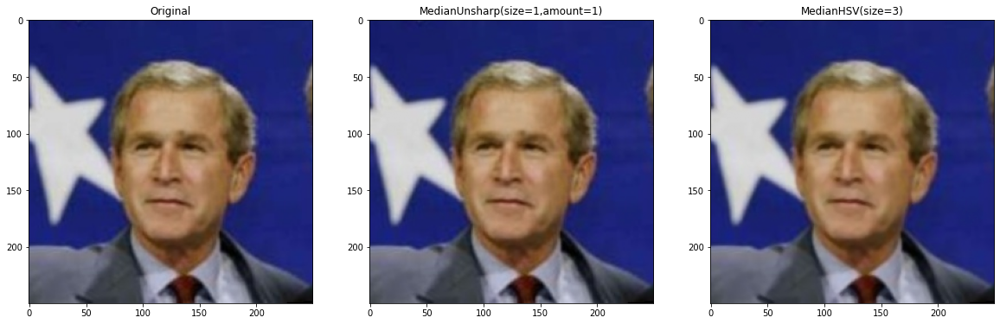

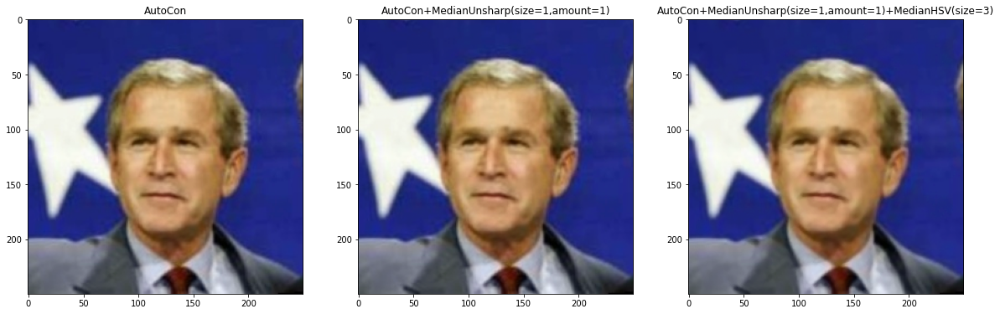

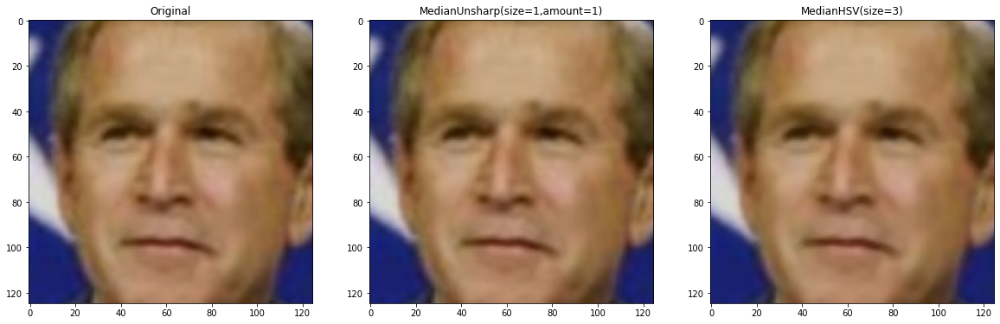

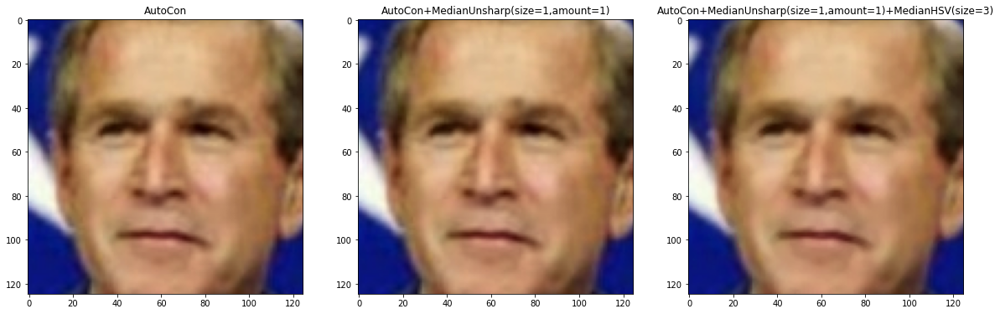

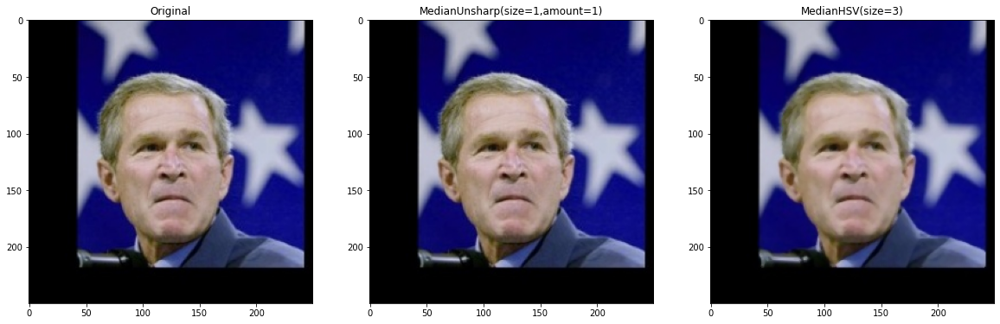

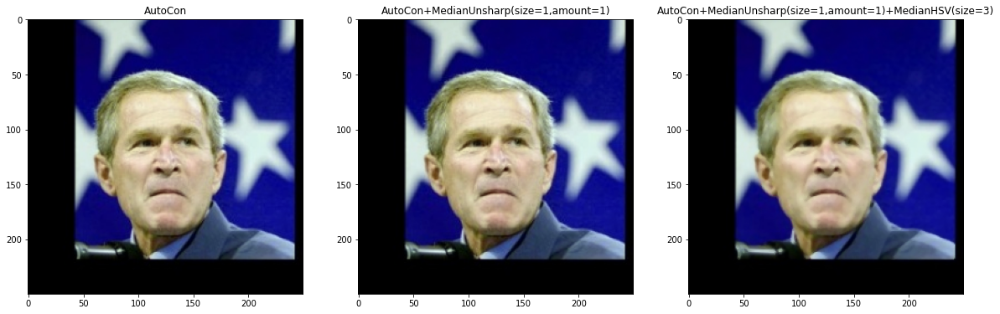

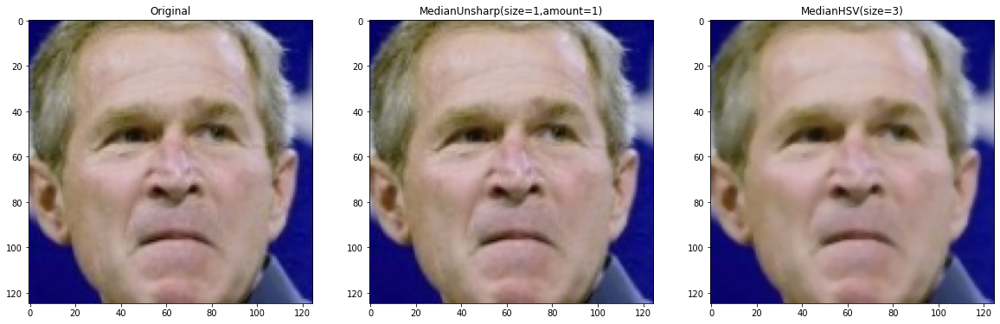

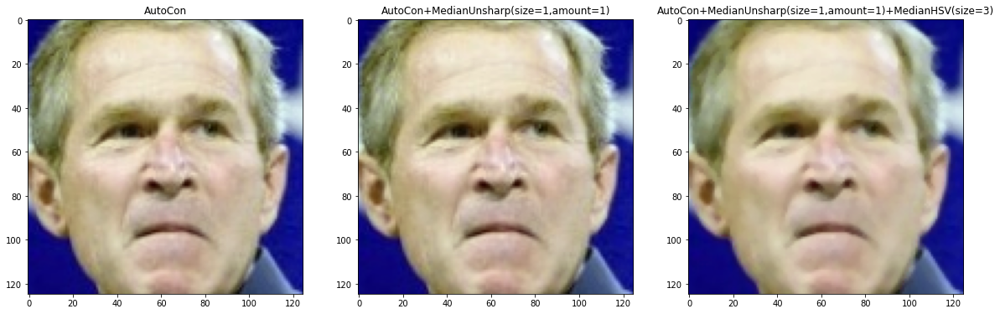

In [52]:
i=0
musize,muamount=1,1
method='sv'
msize=3
for j in range(2):
    image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_00{(i+1)*(j+1):02d}.jpg')
    img = image_file.convert('RGB')
    for center_crop in range(2):
        f,ax=plt.subplots(1,3,figsize=(20,10))
        ax[0].imshow(img)
        ax[0].set_title('Original')
        filtered_img = MedianUnsharpFilter(size=musize,amount=muamount)(img)
        ax[1].imshow(filtered_img)
        ax[1].set_title(f'MedianUnsharp(size={musize},amount={muamount})')
        
        filtered_img = MedianHSVFilter(method=method,size=msize)(img)
        ax[2].imshow(filtered_img)
        ax[2].set_title(f'MedianHSV(size={msize})')
        plt.show()
        f,ax=plt.subplots(1,3,figsize=(20,10))
        filtered_img = AutoContrast()(img)
        ax[0].imshow(filtered_img)
        ax[0].set_title('AutoCon')
        filtered_img = MedianUnsharpFilter(size=musize,amount=muamount)(filtered_img)
        ax[1].imshow(filtered_img)
        ax[1].set_title(f'AutoCon+MedianUnsharp(size={musize},amount={muamount})')
        filtered_img = MedianHSVFilter(method=method,size=msize)(filtered_img)
        ax[2].imshow(filtered_img)
        ax[2].set_title(f'AutoCon+MedianUnsharp(size={musize},amount={muamount})+MedianHSV(size={msize})')
        plt.show()
        img = transforms.CenterCrop(size=125)(img)

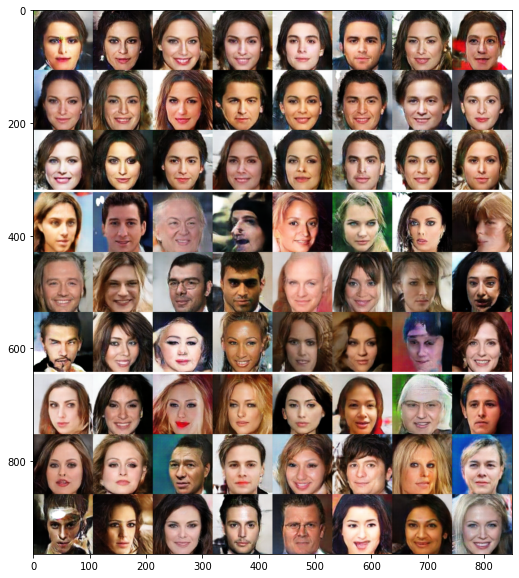

In [68]:
image_file = Image.open(f'./CelebA-Example-8x9.png').convert('RGB')
f, ax = plt.subplots(figsize=(10,10))
ax.imshow(image_file)

time: 0.4235846996307373


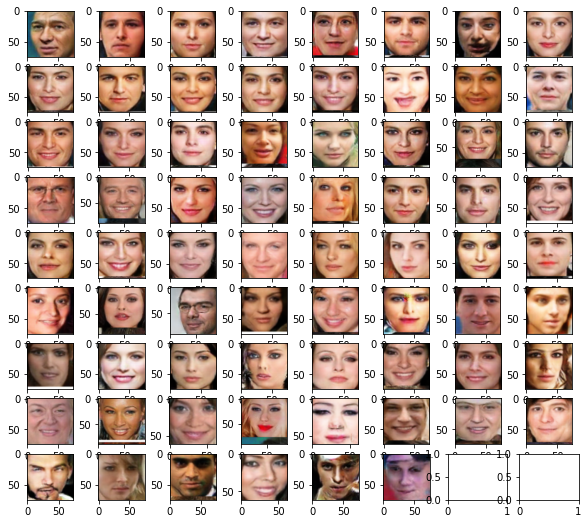

In [82]:
image_file = transforms.Resize((1000,1000))(Image.open(f'./CelebA-Example-8x9.png').convert('RGB'))
then=time.time()
face_locations = face_recognition.face_locations(np.array(image_file))
print(f'time: {time.time()-then}')
# f, ax = plt.subplots(8+1,(len(face_locations)+1)//8, figsize=(10, (len(face_locations)+1)//8))
f, ax = plt.subplots(8+1,8, figsize=(10, 9))
c=0
i=0
for (U,R,D,L) in face_locations:
#     if i == (len(face_locations)+1)//8:
    if i == 8:
        c+=1
        i=0
    ax[c,i].imshow(image_file.crop([L,U,R,D]))
    i+=1
f.show()

time: 0.07161784172058105


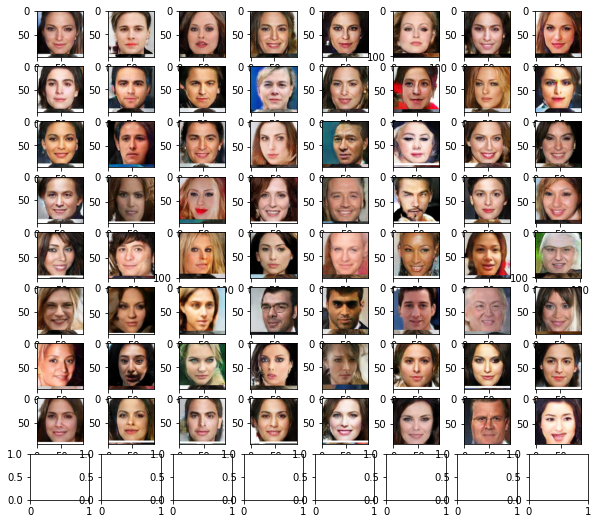

In [26]:
img = cv2.imread('./CelebA-Example-8x9.png')
face_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_frontalface_default.xml"
)
then=time.time()
face_locations = face_classifier.detectMultiScale(
    img, scaleFactor=1.1, minNeighbors=5, minSize=(90, 90)
)
print(f'time: {time.time()-then}')
# f, ax = plt.subplots(8+1,(len(face_locations)+1)//8, figsize=(10, (len(face_locations)+1)//8))
f, ax = plt.subplots(9,8, figsize=(10, 9))
c=0
i=0
for (x,y,w,h) in face_locations:
    L,U,R,D=x,y,x+w,y+h
#     if i == (len(face_locations)+1)//8:
    if i == 8:
        c+=1
        i=0
    ax[c,i].imshow(Image.fromarray(img[:,:,::-1]).crop([L,U,R,D]))
    i+=1
f.show()



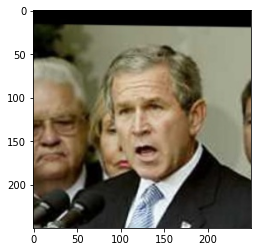

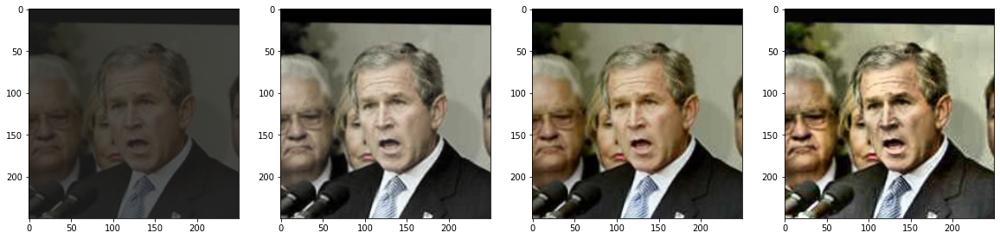

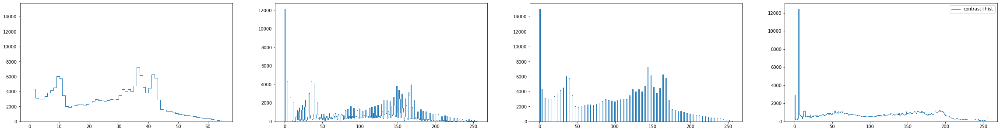

In [56]:
image_file = Image.open(f'./data/lfw-py/lfw_funneled/George_W_Bush/George_W_Bush_0020.jpg')
img = image_file.convert('RGB')
plt.imshow(img)
plt.show()
filtered_img = img
filtered_img = transforms.functional.adjust_brightness(filtered_img,.5)
filtered_img = transforms.functional.adjust_contrast(filtered_img,.5)
# filtered_img = transforms.functional.adjust_saturation(filtered_img,.5)

f,ax=plt.subplots(1,4,figsize=(20,10))
ax[0].imshow(filtered_img)
ax[1].imshow(HistogramEqualization()(filtered_img))
ax[2].imshow(AutoContrast()(filtered_img))
ax[3].imshow(HistogramEqualization(clip_limit=.025)(AutoContrast()(filtered_img)))
plt.show()
f,ax=plt.subplots(1,4,figsize=(40,5))
ax[0].stairs(skimage.exposure.histogram(np.array(filtered_img), nbins=256)[0], label='filtered')
ax[1].stairs(skimage.exposure.histogram(HistogramEqualization()(filtered_img), nbins=256)[0], label='hist')
ax[2].stairs(skimage.exposure.histogram(AutoContrast()(filtered_img), nbins=256)[0], label='contrast')
ax[3].stairs(skimage.exposure.histogram(HistogramEqualization(clip_limit=.025)(AutoContrast()(filtered_img)), nbins=256)[0], label='contrast+hist')
plt.legend()
plt.show()

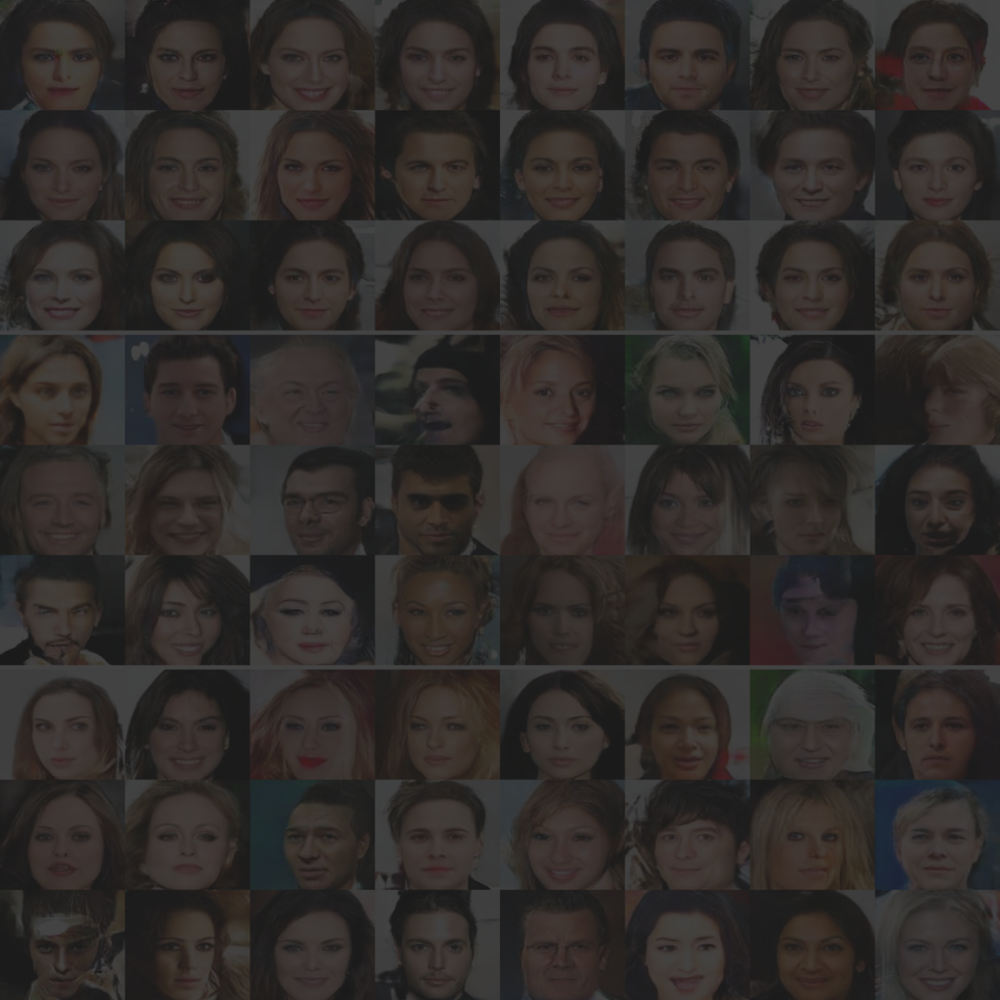

In [7]:
image_file = transforms.Resize((1000,1000))(Image.open(f'../CelebA-Example-8x9.png').convert('RGB'))

time: 0.4153118133544922


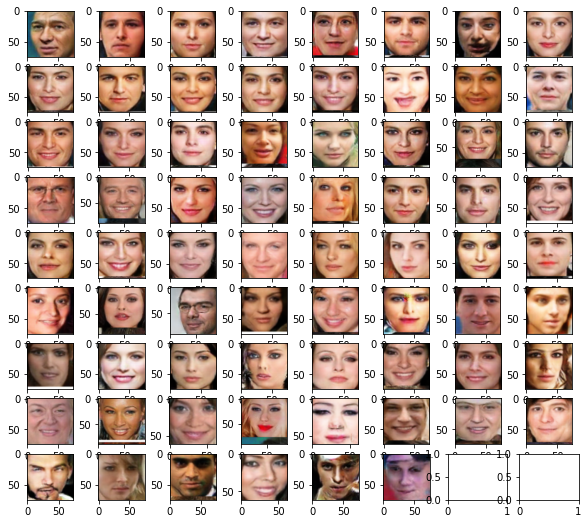

In [20]:
image_file = transforms.Resize((1000,1000))(Image.open(f'../CelebA-Example-8x9.png').convert('RGB'))
filtered_image_file = transforms.functional.adjust_brightness(transforms.functional.adjust_contrast(image_file,.4),.4)
then=time.time()
face_locations = face_recognition.face_locations(np.array(image_file))
print(f'time: {time.time()-then}')
# f, ax = plt.subplots(8+1,(len(face_locations)+1)//8, figsize=(10, (len(face_locations)+1)//8))
f, ax = plt.subplots(8+1,8, figsize=(10, 9))
c=0
i=0
for (U,R,D,L) in face_locations:
#     if i == (len(face_locations)+1)//8:
    if i == 8:
        c+=1
        i=0
    ax[c,i].imshow(image_file.crop([L,U,R,D]))
    i+=1
f.show()

time: 0.41256070137023926


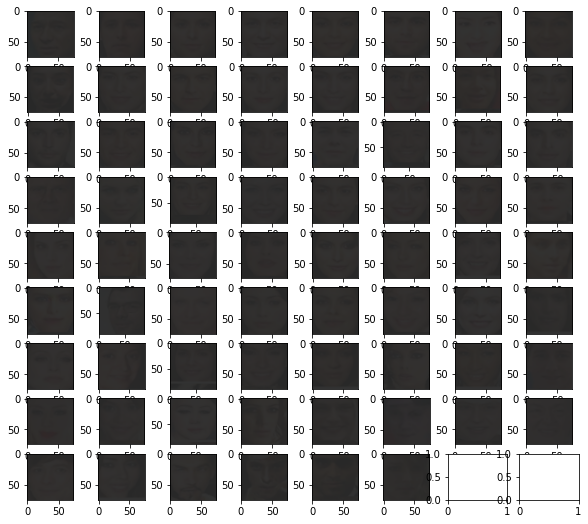

In [28]:
image_file = transforms.Resize((1000,1000))(Image.open(f'../CelebA-Example-8x9.png').convert('RGB'))
filtered_image_file = transforms.functional.adjust_brightness(transforms.functional.adjust_contrast(image_file,.1),.4)
adjusted_image_file = transforms.ToPILImage()(AutoContrast()(filtered_image_file))
then=time.time()
face_locations = face_recognition.face_locations(np.array(adjusted_image_file))
print(f'time: {time.time()-then}')
# f, ax = plt.subplots(8+1,(len(face_locations)+1)//8, figsize=(10, (len(face_locations)+1)//8))
f, ax = plt.subplots(8+1,8, figsize=(10, 9))
c=0
i=0
for (U,R,D,L) in face_locations:
#     if i == (len(face_locations)+1)//8:
    if i == 8:
        c+=1
        i=0
    ax[c,i].imshow(filtered_image_file.crop([L,U,R,D]))
    i+=1
f.show()